# 8x8 Puzzle Solver - Final Version

This notebook tests the LAB + Gradient + A* Region Growing solver.

**Features:**
- LAB color space dissimilarity (better than RGB)
- Gradient continuity for edge matching
- Best Buddy detection for confident pairs
- A*-inspired region growing with ambiguity filtering
- Border variance scoring for orientation

In [1]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path
from IPython.display import display, HTML
import time

from accuracy_utils import (
    load_ground_truth,
    compute_pairwise_neighbor_accuracy,
    arrangement_to_grid,
    reconstruct_image,
)
from pipeline.artifact_pipeline import create_artifact
from solvers.solver_8x8_final import solve_8x8_final

plt.rcParams['figure.figsize'] = (15, 5)
print("Imports OK")

Imports OK


## Helper Functions

In [2]:
def create_artifacts_from_image(image_path: str, grid_size: int = 8) -> dict:
    """Load image and create artifacts for each piece."""
    img = cv2.imread(image_path)
    if img is None:
        raise ValueError(f"Could not load: {image_path}")
    
    h, w = img.shape[:2]
    piece_h, piece_w = h // grid_size, w // grid_size
    
    artifacts = {}
    idx = 0
    for row in range(grid_size):
        for col in range(grid_size):
            y1, y2 = row * piece_h, (row + 1) * piece_h
            x1, x2 = col * piece_w, (col + 1) * piece_w
            piece = img[y1:y2, x1:x2].copy()
            artifacts[idx] = create_artifact(piece)
            idx += 1
    
    return artifacts


def show_comparison(puzzle_path: str, correct_path: str, figsize=(18, 6)):
    """Solve and show side-by-side comparison."""
    # Create artifacts and solve
    artifacts = create_artifacts_from_image(puzzle_path, grid_size=8)
    
    start = time.time()
    board, arrangement, score = solve_8x8_final(artifacts, verbose=False)
    elapsed = time.time() - start
    
    # Compute accuracy
    gt_labels = load_ground_truth(puzzle_path, correct_path, grid_size=8)
    pred_grid = arrangement_to_grid(arrangement, grid_size=8)
    accuracy = compute_pairwise_neighbor_accuracy(pred_grid, gt_labels)
    
    # Load images
    puzzle_img = cv2.cvtColor(cv2.imread(puzzle_path), cv2.COLOR_BGR2RGB)
    correct_img = cv2.cvtColor(cv2.imread(correct_path), cv2.COLOR_BGR2RGB)
    solved_img = cv2.cvtColor(reconstruct_image(artifacts, arrangement, grid_size=8), cv2.COLOR_BGR2RGB)
    
    # Plot
    fig, axes = plt.subplots(1, 3, figsize=figsize)
    
    axes[0].imshow(puzzle_img)
    axes[0].set_title('Shuffled Puzzle')
    axes[0].axis('off')
    
    axes[1].imshow(solved_img)
    axes[1].set_title(f'Solved ({accuracy:.1%} accuracy, {elapsed:.1f}s)')
    axes[1].axis('off')
    
    axes[2].imshow(correct_img)
    axes[2].set_title('Ground Truth')
    axes[2].axis('off')
    
    plt.tight_layout()
    plt.show()
    
    return accuracy, score, elapsed

print("Helper functions defined")

Helper functions defined


## Test Single Image

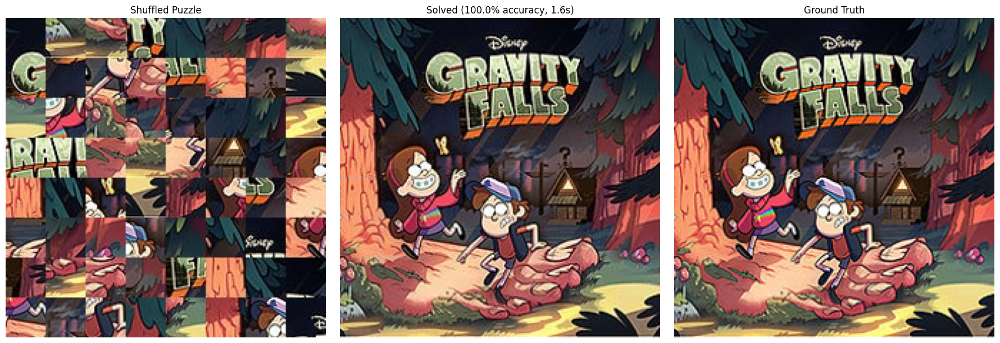


Accuracy: 100.00%
Score: 2993.34
Time: 1.64s


In [3]:
# Test on a single image
puzzle_path = "Gravity Falls/puzzle_8x8/0.jpg"
correct_path = "Gravity Falls/correct/0.png"

accuracy, score, elapsed = show_comparison(puzzle_path, correct_path)
print(f"\nAccuracy: {accuracy:.2%}")
print(f"Score: {score:.2f}")
print(f"Time: {elapsed:.2f}s")

## Test Multiple Images


Image 0


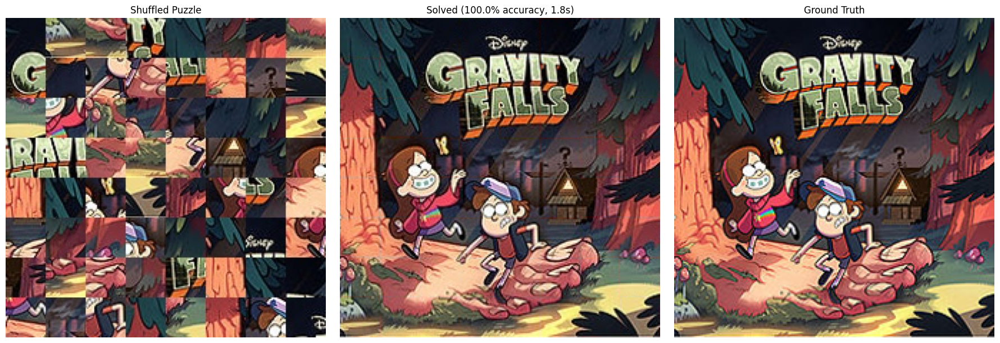


Image 1


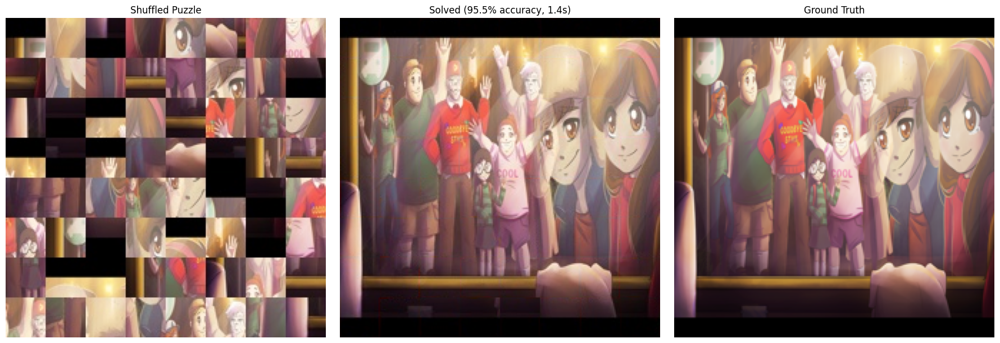


Image 11


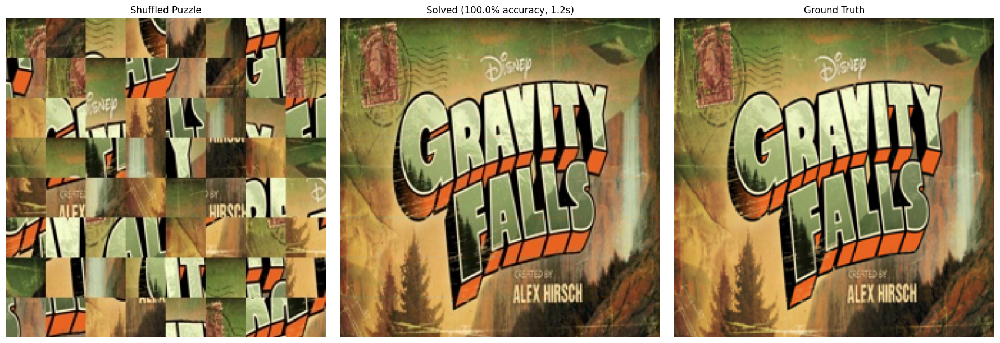


Image 13


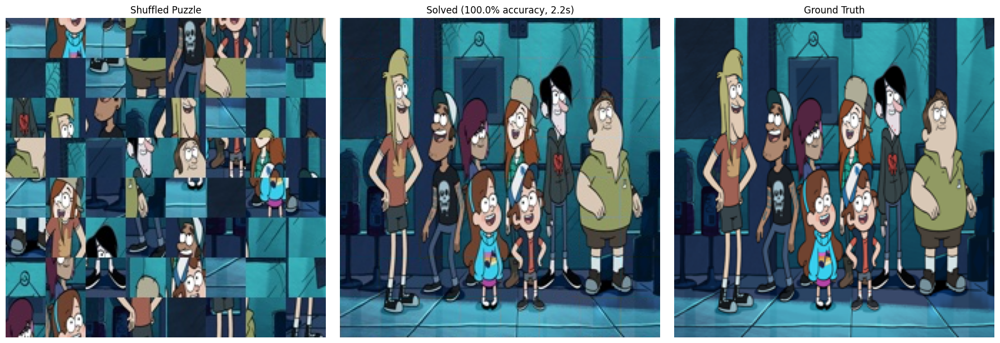


Image 24


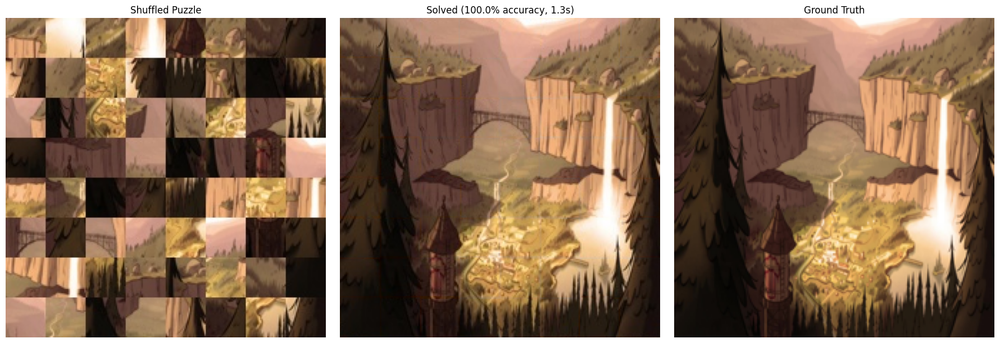


Image 29


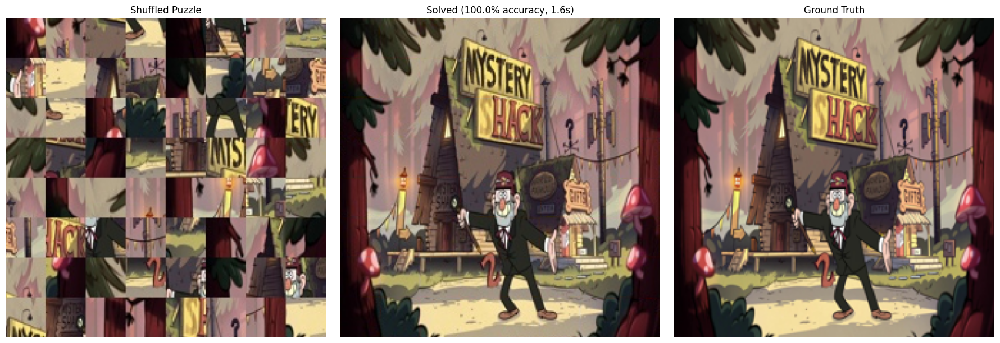


Image 70


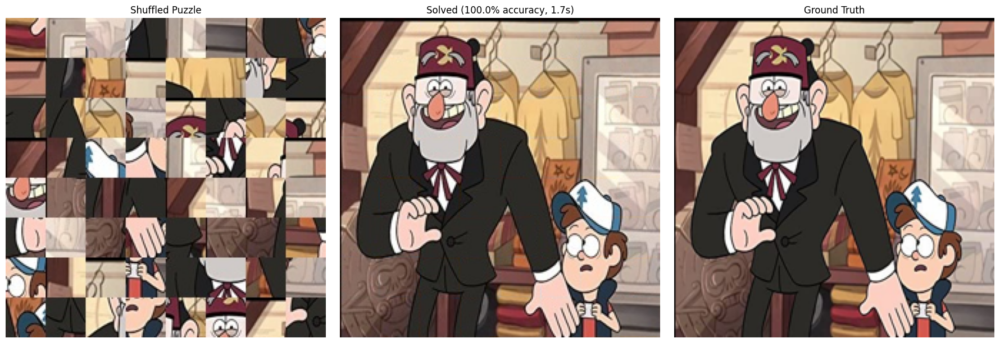


Image 82


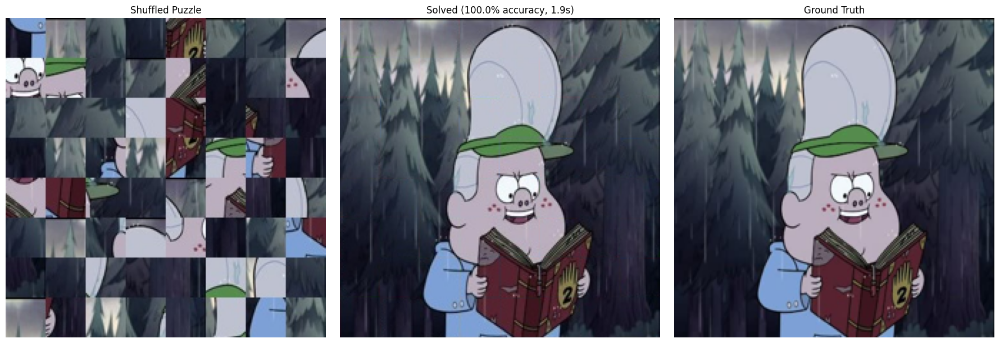

In [4]:
# Test on multiple images
test_indices = [0, 1, 11, 13, 24, 29, 70, 82]  # Mix of easy and hard

for idx in test_indices:
    puzzle_path = f"Gravity Falls/puzzle_8x8/{idx}.jpg"
    correct_path = f"Gravity Falls/correct/{idx}.png"
    
    if Path(puzzle_path).exists() and Path(correct_path).exists():
        print(f"\n{'='*60}")
        print(f"Image {idx}")
        print('='*60)
        accuracy, score, elapsed = show_comparison(puzzle_path, correct_path)
    else:
        print(f"Image {idx}: files not found")

## Batch Test All Images

In [5]:
def batch_test(puzzle_dir: str, correct_dir: str, limit: int = None):
    """Test solver on all images and return results."""
    puzzle_dir = Path(puzzle_dir)
    correct_dir = Path(correct_dir)
    
    puzzle_files = sorted(puzzle_dir.glob("*.jpg")) + sorted(puzzle_dir.glob("*.png"))
    if limit:
        puzzle_files = puzzle_files[:limit]
    
    results = []
    
    for i, puzzle_path in enumerate(puzzle_files):
        stem = puzzle_path.stem
        correct_path = None
        for ext in ['.png', '.jpg']:
            candidate = correct_dir / (stem + ext)
            if candidate.exists():
                correct_path = candidate
                break
        
        if correct_path is None:
            continue
        
        try:
            artifacts = create_artifacts_from_image(str(puzzle_path), grid_size=8)
            start = time.time()
            board, arrangement, score = solve_8x8_final(artifacts, verbose=False)
            elapsed = time.time() - start
            
            gt_labels = load_ground_truth(str(puzzle_path), str(correct_path), grid_size=8)
            pred_grid = arrangement_to_grid(arrangement, grid_size=8)
            accuracy = compute_pairwise_neighbor_accuracy(pred_grid, gt_labels)
            
            results.append({
                'name': puzzle_path.name,
                'accuracy': accuracy,
                'score': score,
                'time': elapsed,
            })
            
            status = "✓" if accuracy >= 0.95 else "○" if accuracy >= 0.70 else "✗"
            print(f"[{i+1}/{len(puzzle_files)}] {puzzle_path.name}: {accuracy:.1%} {status}")
            
        except Exception as e:
            print(f"[{i+1}/{len(puzzle_files)}] {puzzle_path.name}: ERROR - {e}")
    
    return results

# Run batch test
print("Running batch test...\n")
results = batch_test("Gravity Falls/puzzle_8x8", "Gravity Falls/correct")

Running batch test...

[1/110] 0.jpg: 100.0% ✓
[2/110] 1.jpg: 95.5% ✓
[3/110] 10.jpg: 80.4% ○
[4/110] 100.jpg: 71.4% ○
[5/110] 101.jpg: 89.3% ○
[6/110] 102.jpg: 89.3% ○
[7/110] 103.jpg: 75.0% ○
[8/110] 104.jpg: 66.1% ✗
[9/110] 105.jpg: 37.5% ✗
[10/110] 106.jpg: 85.7% ○
[11/110] 107.jpg: 84.8% ○
[12/110] 108.jpg: 79.5% ○
[13/110] 109.jpg: 82.1% ○
[14/110] 11.jpg: 100.0% ✓
[15/110] 12.jpg: 94.6% ○
[16/110] 13.jpg: 100.0% ✓
[17/110] 14.jpg: 71.4% ○
[18/110] 15.jpg: 92.9% ○
[19/110] 16.jpg: 62.5% ✗
[20/110] 17.jpg: 63.4% ✗
[21/110] 18.jpg: 45.5% ✗
[22/110] 19.jpg: 70.5% ○
[23/110] 2.jpg: 74.1% ○
[24/110] 20.jpg: 77.7% ○
[25/110] 21.jpg: 93.8% ○
[26/110] 22.jpg: 67.0% ✗
[27/110] 23.jpg: 81.2% ○
[28/110] 24.jpg: 100.0% ✓
[29/110] 25.jpg: 29.5% ✗
[30/110] 26.jpg: 92.9% ○
[31/110] 27.jpg: 87.5% ○
[32/110] 28.jpg: 90.2% ○
[33/110] 29.jpg: 100.0% ✓
[34/110] 3.jpg: 85.7% ○
[35/110] 30.jpg: 35.7% ✗
[36/110] 31.jpg: 30.4% ✗
[37/110] 32.jpg: 77.7% ○
[38/110] 33.jpg: 74.1% ○
[39/110] 34.jpg: 54.5% ✗


## Results Summary

In [6]:
if results:
    accuracies = [r['accuracy'] for r in results]
    times = [r['time'] for r in results]
    
    print("="*60)
    print("SUMMARY")
    print("="*60)
    print(f"Total images: {len(results)}")
    print(f"Mean accuracy: {np.mean(accuracies):.2%}")
    print(f"Median accuracy: {np.median(accuracies):.2%}")
    print(f"Min accuracy: {np.min(accuracies):.2%}")
    print(f"Max accuracy: {np.max(accuracies):.2%}")
    print(f"Perfect (≥95%): {sum(1 for a in accuracies if a >= 0.95)}/{len(results)}")
    print(f"Good (≥70%): {sum(1 for a in accuracies if a >= 0.70)}/{len(results)}")
    print(f"Mean time: {np.mean(times):.2f}s")

SUMMARY
Total images: 110
Mean accuracy: 74.47%
Median accuracy: 76.79%
Min accuracy: 29.46%
Max accuracy: 100.00%
Perfect (≥95%): 8/110
Good (≥70%): 76/110
Mean time: 1.81s


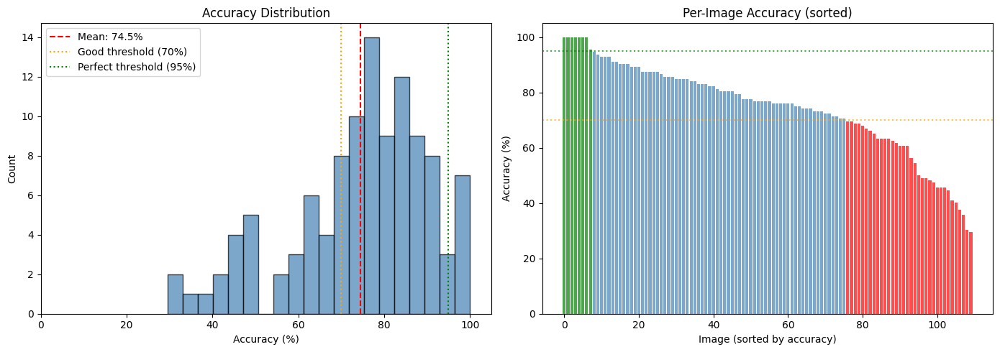

In [7]:
# Plot accuracy distribution
if results:
    accuracies = [r['accuracy'] * 100 for r in results]
    
    fig, axes = plt.subplots(1, 2, figsize=(14, 5))
    
    # Histogram
    axes[0].hist(accuracies, bins=20, edgecolor='black', alpha=0.7, color='steelblue')
    axes[0].axvline(np.mean(accuracies), color='red', linestyle='--', label=f'Mean: {np.mean(accuracies):.1f}%')
    axes[0].axvline(70, color='orange', linestyle=':', label='Good threshold (70%)')
    axes[0].axvline(95, color='green', linestyle=':', label='Perfect threshold (95%)')
    axes[0].set_xlabel('Accuracy (%)')
    axes[0].set_ylabel('Count')
    axes[0].set_title('Accuracy Distribution')
    axes[0].legend()
    axes[0].set_xlim(0, 105)
    
    # Sorted accuracy
    sorted_acc = sorted(accuracies, reverse=True)
    colors = ['green' if a >= 95 else 'steelblue' if a >= 70 else 'red' for a in sorted_acc]
    axes[1].bar(range(len(sorted_acc)), sorted_acc, color=colors, alpha=0.7)
    axes[1].axhline(70, color='orange', linestyle=':', alpha=0.7)
    axes[1].axhline(95, color='green', linestyle=':', alpha=0.7)
    axes[1].set_xlabel('Image (sorted by accuracy)')
    axes[1].set_ylabel('Accuracy (%)')
    axes[1].set_title('Per-Image Accuracy (sorted)')
    axes[1].set_ylim(0, 105)
    
    plt.tight_layout()
    plt.show()

## Worst Cases Analysis

Worst 5 images:
  25.jpg: 29.5%
  31.jpg: 30.4%
  30.jpg: 35.7%
  105.jpg: 37.5%
  45.jpg: 40.2%

Visualizing worst cases...

25.jpg:


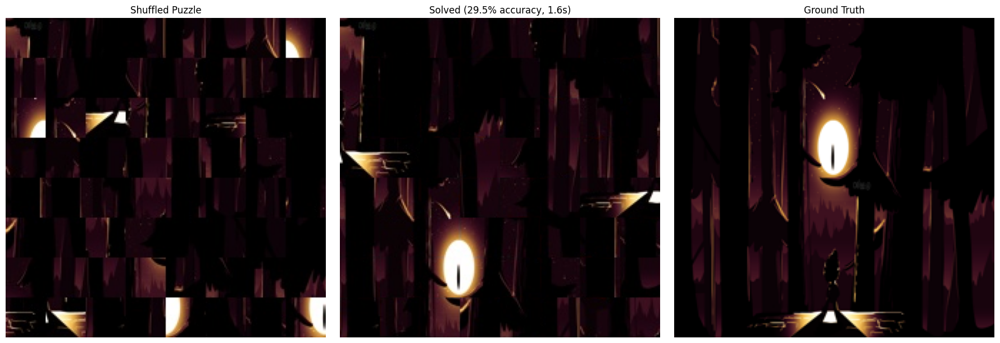


31.jpg:


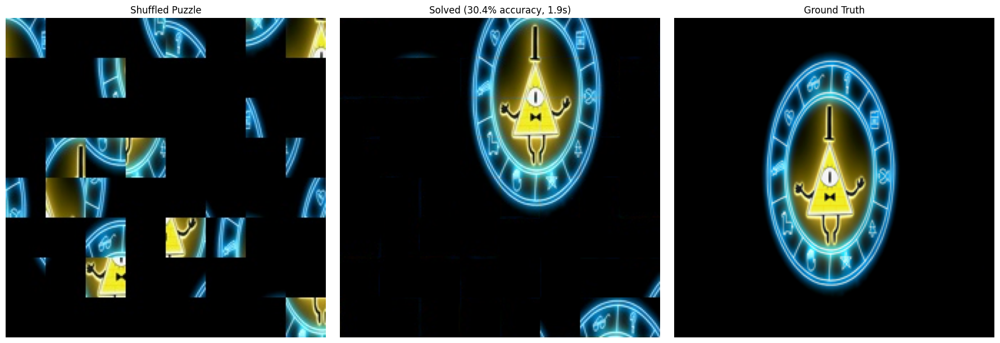


30.jpg:


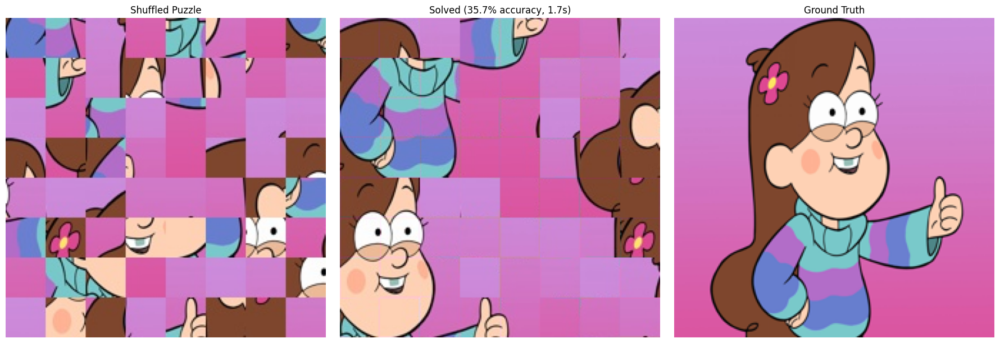

In [8]:
# Show worst performing images
if results:
    worst = sorted(results, key=lambda x: x['accuracy'])[:5]
    
    print("Worst 5 images:")
    for r in worst:
        print(f"  {r['name']}: {r['accuracy']:.1%}")
    
    print("\nVisualizing worst cases...")
    for r in worst[:3]:
        stem = Path(r['name']).stem
        puzzle_path = f"Gravity Falls/puzzle_8x8/{r['name']}"
        correct_path = f"Gravity Falls/correct/{stem}.png"
        
        if Path(puzzle_path).exists() and Path(correct_path).exists():
            print(f"\n{r['name']}:")
            show_comparison(puzzle_path, correct_path)

## Best Cases

Best 5 images:
  0.jpg: 100.0%
  11.jpg: 100.0%
  13.jpg: 100.0%
  24.jpg: 100.0%
  29.jpg: 100.0%

Visualizing best cases...

0.jpg:


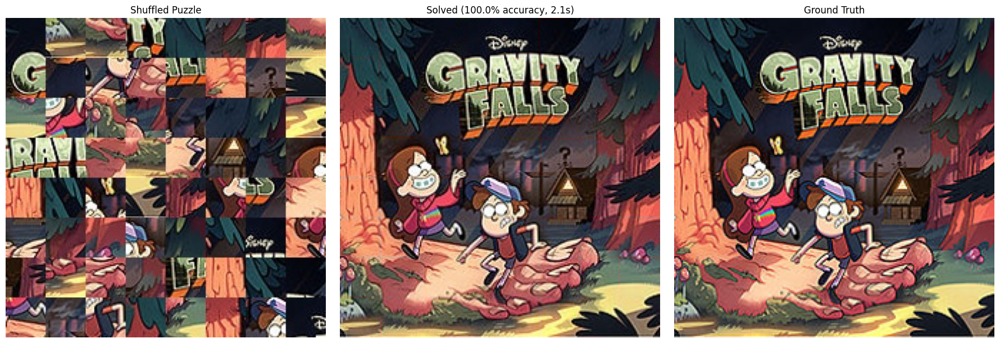


11.jpg:


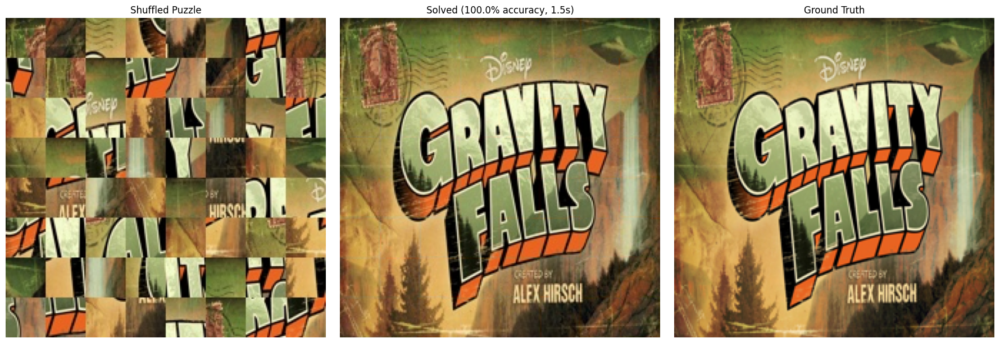


13.jpg:


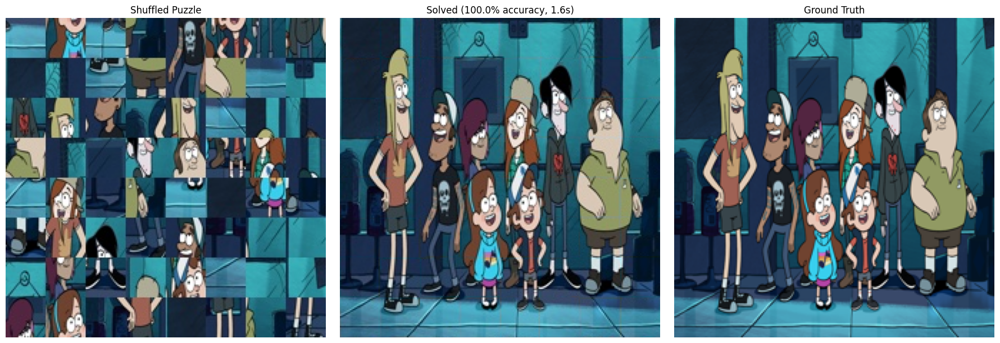

In [9]:
# Show best performing images
if results:
    best = sorted(results, key=lambda x: x['accuracy'], reverse=True)[:5]
    
    print("Best 5 images:")
    for r in best:
        print(f"  {r['name']}: {r['accuracy']:.1%}")
    
    print("\nVisualizing best cases...")
    for r in best[:3]:
        stem = Path(r['name']).stem
        puzzle_path = f"Gravity Falls/puzzle_8x8/{r['name']}"
        correct_path = f"Gravity Falls/correct/{stem}.png"
        
        if Path(puzzle_path).exists() and Path(correct_path).exists():
            print(f"\n{r['name']}:")
            show_comparison(puzzle_path, correct_path)